In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
from matplotlib import pyplot as plt

# %matplotlib inline

In [2]:
df = pd.read_csv("Dataset/Crop_recommendation.csv")
df.sample(5)

,N,P,K,temperature,humidity,ph,rainfall,label
228,54,77,85,17.141861,17.066243,7.829211,83.746067,chickpea
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
292,39,76,76,19.968375,15.573244,8.135901,69.157591,chickpea
682,6,47,18,29.161746,80.280381,6.715277,40.165460,mungbean
749,53,74,15,29.434638,64.943294,7.517097,72.178182,blackgram


In [3]:
# Let's rename the columns
print(list(df.columns))

['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label']


In [4]:
df.rename(
    columns={
        "temperature": "TC",
        "humidity": "RH",
        "ph": "pH",
        "rainfall": "RF",
        "label": "Crop",
    },
    inplace=True,
)
df.sample(5)

,N,P,K,TC,RH,pH,RF,Crop
1897,23,21,26,26.454887,93.450426,5.901496,149.222026,coconut
1991,131,56,20,22.008171,81.838961,7.762648,92.236452,cotton
2022,84,55,38,26.874839,79.787252,6.956683,173.101710,jute
1986,118,44,23,22.084583,82.829041,6.691690,67.064598,cotton
1151,21,31,32,35.385987,51.426642,5.254532,90.296439,mango


In [5]:
# See the data type
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   N       2200 non-null   int64  
 1   P       2200 non-null   int64  
 2   K       2200 non-null   int64  
 3   TC      2200 non-null   float64
 4   RH      2200 non-null   float64
 5   pH      2200 non-null   float64
 6   RF      2200 non-null   float64
 7   Crop    2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB


In [6]:
# There are no nulls, which is good.

# let's see the percentiles of each feature
df.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
N,2200.0,NaN,NaN,NaN,50.551818,36.917334,0.0,21.0,37.0,84.25,140.0
P,2200.0,NaN,NaN,NaN,53.362727,32.985883,5.0,28.0,51.0,68.0,145.0
K,2200.0,NaN,NaN,NaN,48.149091,50.647931,5.0,20.0,32.0,49.0,205.0
TC,2200.0,NaN,NaN,NaN,25.616244,5.063749,8.825675,22.769375,25.598693,28.561654,43.675493
RH,2200.0,NaN,NaN,NaN,71.481779,22.263812,14.25804,60.261953,80.473146,89.948771,99.981876
pH,2200.0,NaN,NaN,NaN,6.46948,0.773938,3.504752,5.971693,6.425045,6.923643,9.935091
RF,2200.0,NaN,NaN,NaN,103.463655,54.958389,20.211267,64.551686,94.867624,124.267508,298.560117
Crop,2200,22,rice,100,NaN,NaN,NaN,NaN,NaN,NaN,NaN


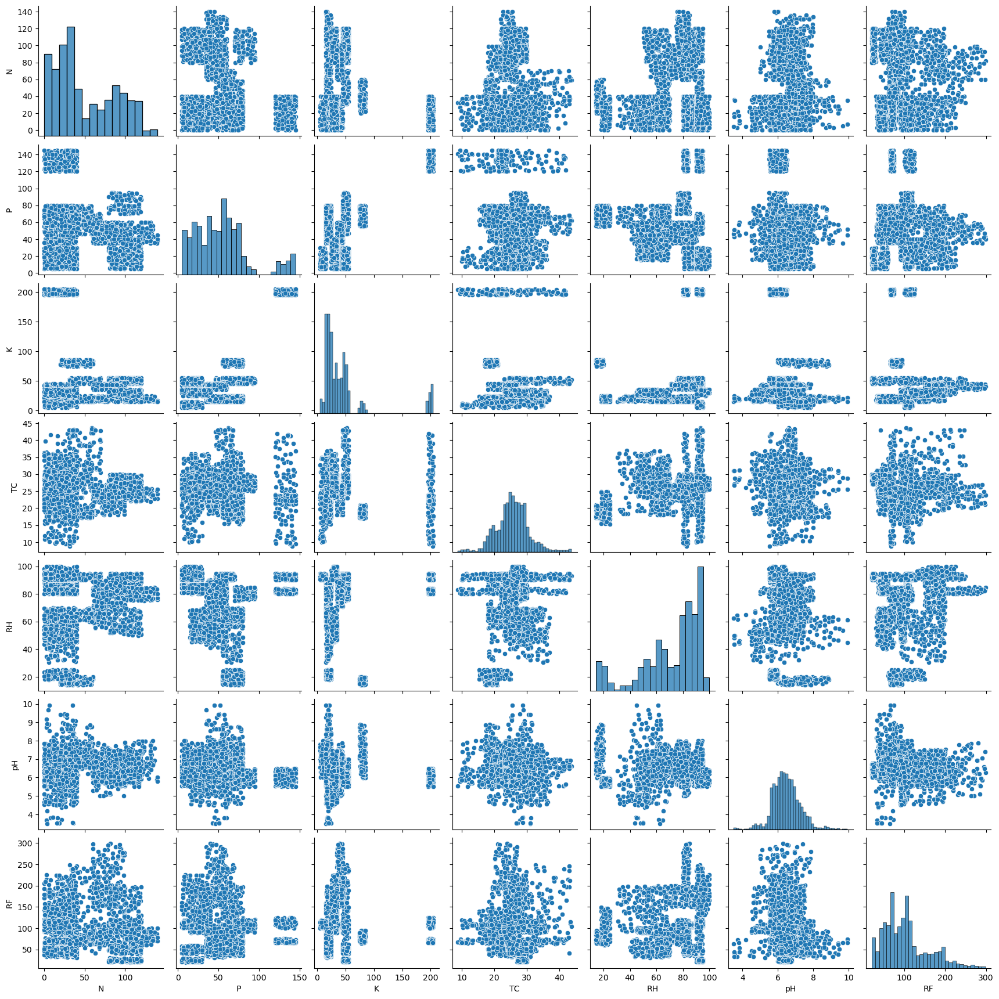

In [7]:
# are there any relationships between features?
# %matplotlib inline
sns.pairplot(df, vars=df.columns[:-1])

In [8]:
# The data range of each crop
# summary = df.groupby('Crop', sort=True).agg(['min', 'max', 'count'])
summary = df.groupby("Crop", sort=True).agg(["min", "max"]).map(lambda x: f"{x:.2f}")
# # Format min and max as 0.00, leave count as is
# for col in summary.columns.levels[0]:
#     if ('min' in summary[col]) and ('max' in summary[col]):
#         summary[(col, 'min')] = summary[(col, 'min')].map("{:.2f}".format)
#         summary[(col, 'max')] = summary[(col, 'max')].map("{:.2f}".format)
summary

N               P               K             TC         \
                min     max     min     max     min     max    min    max   
Crop                                                                        
apple          0.00   40.00  120.00  145.00  195.00  205.00  21.04  24.00   
banana        80.00  120.00   70.00   95.00   45.00   55.00  25.01  29.91   
blackgram     20.00   60.00   55.00   80.00   15.00   25.00  25.10  34.95   
chickpea      20.00   60.00   55.00   80.00   75.00   85.00  17.02  21.00   
coconut        0.00   40.00    5.00   30.00   25.00   35.00  25.01  29.87   
coffee        80.00  120.00   15.00   40.00   25.00   35.00  23.06  27.92   
cotton       100.00  140.00   35.00   60.00   15.00   25.00  22.00  25.99   
grapes         0.00   40.00  120.00  145.00  195.00  205.00   8.83  41.95   
jute          60.00  100.00   35.00   60.00   35.00   45.00  23.09  26.99   
kidneybeans    0.00   40.00   55.00   80.00   15.00   25.00  15.33  24.92   
lentil         0.00   40.00   55.00   80.00   15.00   25.00  18.06  29.94   
maize         60.00  100.00   35.00   60.00   15.00   25.00  18.04  26.55   
mango          0.00   40.00   15.00   40.00   25.00   35.00  27.00  35.99   
mothbeans      0.00   40.00   35.00   60.00   15.00   25.00  24.02  32.00   
mungbean       0.00   40.00   35.00   60.00   15.00   25.00  27.01  29.91   
muskmelon     80.00  120.00    5.00   30.00   45.00   55.00  27.02  29.94   
orange         0.00   40.00    5.00   30.00    5.00   15.00  10.01  34.91   
papaya        31.00   70.00   46.00   70.00   45.00   55.00  23.01  43.68   
pigeonpeas     0.00   40.00   55.00   80.00   15.00   25.00  18.32  36.98   
pomegranate    0.00   40.00    5.00   30.00   35.00   45.00  18.07  24.96   
rice          60.00   99.00   35.00   60.00   35.00   45.00  20.05  26.93   
watermelon    80.00  120.00    5.00   30.00   45.00   55.00  24.04  26.99   

                RH           pH            RF          
               min    max   min   max     min     max  
Crop                                                   
apple        90.03  94.92  5.51  6.50  100.12  124.98  
banana       75.03  84.98  5.51  6.49   90.11  119.85  
blackgram    60.07  69.96  6.50  7.78   60.42   74.92  
chickpea     14.26  19.97  5.99  8.87   65.11   94.78  
coconut      90.02  99.98  5.50  6.47  131.09  225.63  
coffee       50.05  69.95  6.02  7.49  115.16  199.47  
cotton       75.01  84.88  5.80  7.99   60.65   99.93  
grapes       80.02  83.98  5.51  6.50   65.01   74.92  
jute         70.88  89.89  6.00  7.49  150.24  199.84  
kidneybeans  18.09  24.97  5.50  6.00   60.28  149.74  
lentil       60.09  69.92  5.92  7.84   35.03   54.94  
maize        55.28  74.83  5.51  7.00   60.65  109.75  
mango        45.02  54.96  4.51  6.97   89.29  100.81  
mothbeans    40.01  64.96  3.50  9.94   30.92   74.44  
mungbean     80.03  90.00  6.22  7.20   36.12   59.87  
muskmelon    90.02  94.96  6.00  6.78   20.21   29.87  
orange       90.01  94.96  6.01  8.00  100.17  119.69  
papaya       90.04  94.94  6.50  6.99   40.35  248.86  
pigeonpeas   30.40  69.69  4.55  7.45   90.05  198.83  
pomegranate  85.13  95.00  5.56  7.20  102.52  112.48  
rice         80.12  84.97  5.01  7.87  182.56  298.56  
watermelon   80.03  89.98  6.00  6.96   40.13   59.76

In [9]:
df.groupby("Crop", sort=True).count().T

Crop,apple,banana,blackgram,chickpea,coconut,coffee,cotton,grapes,jute,kidneybeans,...,mango,mothbeans,mungbean,muskmelon,orange,papaya,pigeonpeas,pomegranate,rice,watermelon
N,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100
P,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100
K,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100
TC,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100
RH,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100
pH,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100
RF,100,100,100,100,100,100,100,100,100,100,...,100,100,100,100,100,100,100,100,100,100


**The data shows that all the crops have equal number of records**


# Machine learning stuff
1. Prepare the data set (X and y)
2. Encode the categorical labels (crops)
3. train-test split
4. chose a classifier
5. define the model
6. train the model and see the results
7. see features contribution
8. Model optimization
9. 

In [10]:
# 1. Prepare the data set (X and y)

X = df.drop(columns=["Crop"])
y = df.Crop
print(X.shape, y.shape)

(2200, 7) (2200,)


In [11]:
# Load lybraries
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

In [12]:
# 2. Encode the categorical labels (crops)

# define the label encoder
le = LabelEncoder()
y_encoded = le.fit_transform(y)
y_encoded, y_encoded.shape

(array([20, 20, 20, ...,  5,  5,  5]), (2200,))

In [13]:
# 3. train-test split

X_train, X_test, y_train, y_test = train_test_split(
    X, y_encoded, test_size=0.2, random_state=179, stratify=y_encoded
)

## Important Note
`stratify=y_encoded` ensures that the class distribution in the train and test sets is similar to the original dataset. So, if some crops are rare, random splitting might accidentally put all samples of a rare crop in the training set, and none in the test set (or vice versa). This leads to:  Biased evaluation or Unreliable performance estimates. 

Applying the `stratify=y_encoded` avoids this possibility.

In [14]:
# 4. chose a classifier and 5.define the model

model = RandomForestClassifier(n_estimators=100, random_state=179)

# 6. train the model and see the results
model.fit(X_train, y_train)

RandomForestClassifier(random_state=179)

In [15]:
# %config Completer.use_jedi = True

In [16]:
# test accuracy
y_pred = model.predict(X_test)

print(f"Accuracy = {accuracy_score(y_test, y_pred)}")
print(classification_report(y_test, y_pred, target_names=le.classes_))

Accuracy = 0.9931818181818182
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        20
      banana       1.00      1.00      1.00        20
   blackgram       1.00      1.00      1.00        20
    chickpea       1.00      1.00      1.00        20
     coconut       1.00      1.00      1.00        20
      coffee       1.00      1.00      1.00        20
      cotton       1.00      1.00      1.00        20
      grapes       1.00      1.00      1.00        20
        jute       0.90      0.95      0.93        20
 kidneybeans       1.00      1.00      1.00        20
      lentil       1.00      1.00      1.00        20
       maize       1.00      1.00      1.00        20
       mango       1.00      1.00      1.00        20
   mothbeans       1.00      1.00      1.00        20
    mungbean       1.00      1.00      1.00        20
   muskmelon       1.00      1.00      1.00        20
      orange       1.00      1.00      1.00        

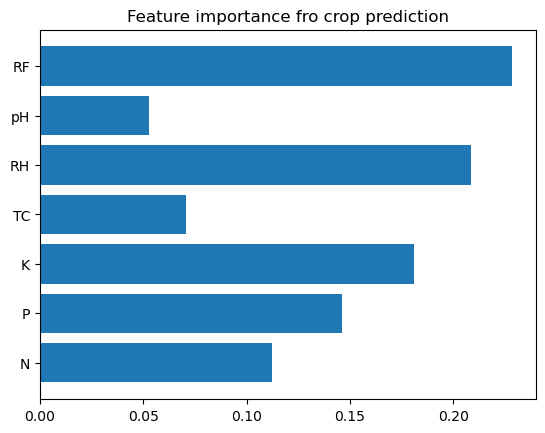

In [17]:
# 7. see features contribution

importances = model.feature_importances_
plt.barh(
    X.columns,
    importances,
)
plt.title("Feature importance fro crop prediction")
plt.show();

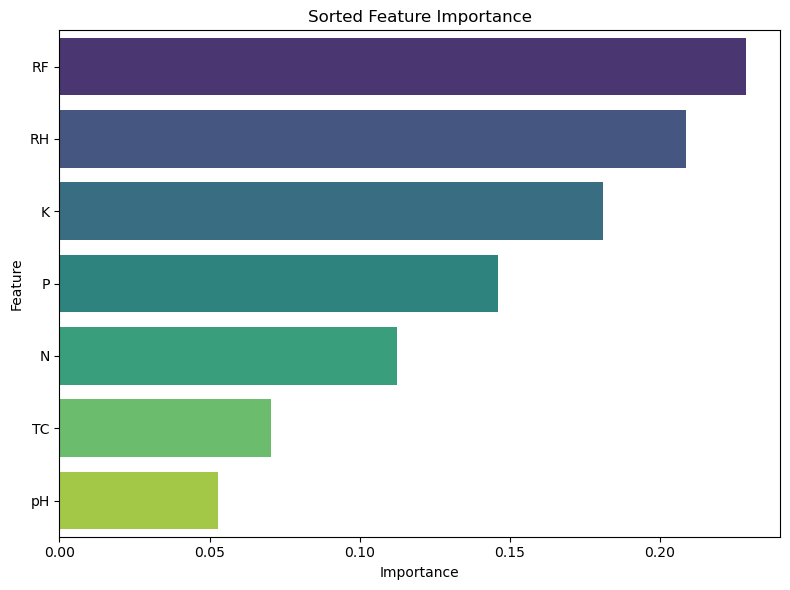

In [18]:
# to sort them
imp_df = pd.DataFrame({"Feature": X.columns, "Importance": importances}).sort_values(
    by="Importance", ascending=False
)

# Plot with Seaborn
plt.figure(figsize=(8, 6))
sns.barplot(
    data=imp_df,
    y="Feature",
    x="Importance",
    palette="viridis",
    hue="Feature",
)

plt.title("Sorted Feature Importance")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()

In [19]:
# By plotly
fig = px.bar(
    imp_df.sort_values("Importance", ascending=True),
    x="Importance",
    y="Feature",
    orientation="h",
    title="Sorted Feature Importance",
    text="Importance",
    color='Feature'
)
fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')
fig.update_layout(yaxis=dict(tickfont=dict(size=15)),height=600)
fig.show()

In [20]:
# Normalize to percent
imp_df["Importance_pct"] = 100 * imp_df["Importance"] / imp_df["Importance"].sum()
# Plot
fig = px.bar(
    imp_df.sort_values("Importance_pct", ascending=True),
    x="Importance_pct",
    y="Feature",
    orientation='h',
    text="Importance_pct",
    color="Feature",
    title="Feature Importance (% of total)"
)
# Format labels as percentages with 1 decimal
fig.update_traces(texttemplate='%{text:.1f}%', textposition='outside')
fig.update_layout(showlegend=False, height=600, xaxis_title="Importance (%)")
fig.show()

## *Since the prediction accuracy is high (99.31), I think we should test the confusion matrix and some other metrics.*

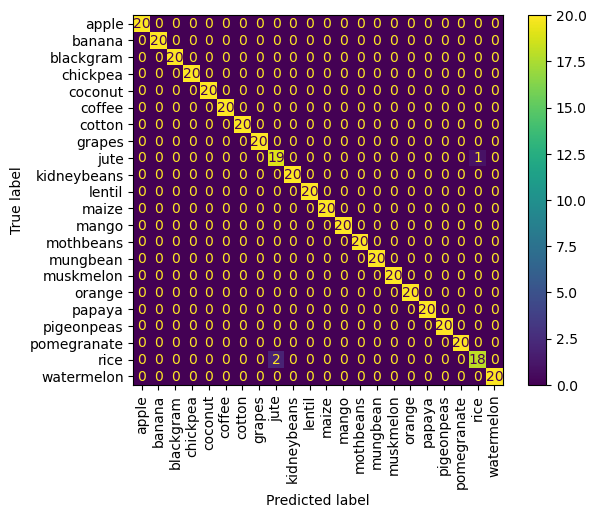

In [21]:
# Confusion Matrix, Shows where the model makes mistakes, per class.

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm=confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(cm,display_labels=le.classes_)
disp.plot(xticks_rotation=90)

In [22]:
 # Precision, Recall, F1-Score (per class)
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred, target_names=le.classes_))

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        20
      banana       1.00      1.00      1.00        20
   blackgram       1.00      1.00      1.00        20
    chickpea       1.00      1.00      1.00        20
     coconut       1.00      1.00      1.00        20
      coffee       1.00      1.00      1.00        20
      cotton       1.00      1.00      1.00        20
      grapes       1.00      1.00      1.00        20
        jute       0.90      0.95      0.93        20
 kidneybeans       1.00      1.00      1.00        20
      lentil       1.00      1.00      1.00        20
       maize       1.00      1.00      1.00        20
       mango       1.00      1.00      1.00        20
   mothbeans       1.00      1.00      1.00        20
    mungbean       1.00      1.00      1.00        20
   muskmelon       1.00      1.00      1.00        20
      orange       1.00      1.00      1.00        20
      papaya       1.00    

# What if the training set were 70% instead of the 80% in the previous works?

In [23]:
# 3. train-test split

X_train, X_test, y_train, y_test = train_test_split(
    X, y_encoded, test_size=0.3, random_state=179, stratify=y_encoded
)
# 4. chose a classifier and 5.define the model

model = RandomForestClassifier(n_estimators=100, random_state=179)

# 6. train the model and see the results
model.fit(X_train, y_train)

# test accuracy
y_pred = model.predict(X_test)

print(f"Accuracy = {accuracy_score(y_test, y_pred)}")
print(classification_report(y_test, y_pred, target_names=le.classes_))

Accuracy = 0.9954545454545455
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        30
   blackgram       1.00      1.00      1.00        30
    chickpea       1.00      1.00      1.00        30
     coconut       1.00      1.00      1.00        30
      coffee       1.00      1.00      1.00        30
      cotton       1.00      1.00      1.00        30
      grapes       1.00      1.00      1.00        30
        jute       0.94      0.97      0.95        30
 kidneybeans       1.00      1.00      1.00        30
      lentil       1.00      1.00      1.00        30
       maize       1.00      1.00      1.00        30
       mango       1.00      1.00      1.00        30
   mothbeans       1.00      1.00      1.00        30
    mungbean       1.00      1.00      1.00        30
   muskmelon       1.00      1.00      1.00        30
      orange       1.00      1.00      1.00        

In [24]:
# 7. see features contribution

importances = model.feature_importances_
# to sort them
imp_df = pd.DataFrame({"Feature": X.columns, "Importance": importances}).sort_values(
    by="Importance", ascending=False
)
# By plotly
fig = px.bar(
    imp_df.sort_values("Importance", ascending=True),
    x="Importance",
    y="Feature",
    orientation="h",
    title="Sorted Feature Importance",
    text="Importance",
    color='Feature'
)
fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')
fig.update_layout(yaxis=dict(tickfont=dict(size=15)),height=600)
fig.show()

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        30
   blackgram       1.00      1.00      1.00        30
    chickpea       1.00      1.00      1.00        30
     coconut       1.00      1.00      1.00        30
      coffee       1.00      1.00      1.00        30
      cotton       1.00      1.00      1.00        30
      grapes       1.00      1.00      1.00        30
        jute       0.94      0.97      0.95        30
 kidneybeans       1.00      1.00      1.00        30
      lentil       1.00      1.00      1.00        30
       maize       1.00      1.00      1.00        30
       mango       1.00      1.00      1.00        30
   mothbeans       1.00      1.00      1.00        30
    mungbean       1.00      1.00      1.00        30
   muskmelon       1.00      1.00      1.00        30
      orange       1.00      1.00      1.00        30
      papaya       1.00    

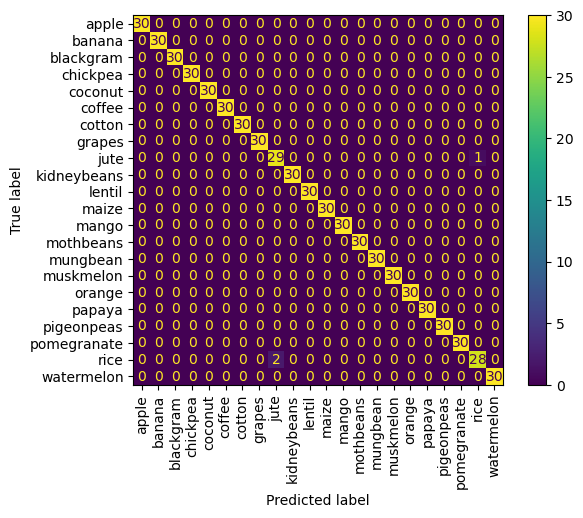

In [25]:
# Confusion Matrix, Shows where the model makes mistakes, per class.
cm=confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(cm,display_labels=le.classes_)
disp.plot(xticks_rotation=90)

 # Precision, Recall, F1-Score (per class)
print(classification_report(y_test, y_pred, target_names=le.classes_))